TASK Set-

Identify complete and incomplete - unique requests ( 10 minutes each. Prepare 6 models for requirements.)
1st Across Kolkata.
Next 5 across the HotZones.

Step 1- DATA CLEANING to filter out unique requests. 
Step 2 identifying HotZones.
Step 3 Model.

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
completed=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Completed Ride - Apr 22, 2024 - Apr 28, 2024 (1).csv")
completed2=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Completed Ride Details - Apr 29, 2024 - May 5, 2024 (1).csv")
completed3=pd.read_excel("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Completed Ride Details.xlsx")
incompleted=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Incomplete Ride Details (Historical) - Apr 1, 2024 - Apr 14, 2024.csv")
incompleted2=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Incomplete Ride Details (Historical) - Apr 15, 2024 - Apr 30, 2024.csv")
incompleted3=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Incomplete Ride Details (Historical) - May 1, 2024 - May 20, 2024.csv")

/var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/2198419674.py:5: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  completed=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Completed Ride - Apr 22, 2024 - Apr 28, 2024 (1).csv")
/var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/2198419674.py:6: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  completed2=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Completed Ride Details - Apr 29, 2024 - May 5, 2024 (1).csv")
/var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/2198419674.py:8: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  incompleted=pd.read_csv("/Users/aayushjain/codes/projects/company assignements/Snape/City Heatmap/dataset/Incomplete Ride Det

In [3]:
incompleted_final = pd.concat([incompleted,incompleted2, incompleted3], ignore_index=True)
completed_final=pd.concat([completed,completed2,completed3],ignore_index=True)

In [4]:
incompleted_final=incompleted_final[['user_id','pickup_lat_long','request_made_at']]
completed_final=completed_final[['user_id','pickup_lat_long','request_made_at']]

In [5]:
dataset=pd.concat([completed_final,incompleted_final],ignore_index=True)

In [6]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 540734 entries, 0 to 540733
Data columns (total 3 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   user_id          540734 non-null  int64 
 1   pickup_lat_long  540734 non-null  object
 2   request_made_at  540734 non-null  object
dtypes: int64(1), object(2)
memory usage: 12.4+ MB


In [7]:
import pandas as pd

dataset['date_column'] = pd.to_datetime(dataset['request_made_at'], format='%Y-%m-%d %H:%M:%S', errors='coerce')
dataset['date_column'] = dataset['date_column'].fillna(pd.to_datetime(dataset['request_made_at'], format='%m/%d/%Y %H:%M', errors='coerce'))

In [8]:
dataset[dataset['request_made_at']=='4/23/2024 23:51']

,user_id,pickup_lat_long,request_made_at,date_column
224361,13751274,"22.6014,88.3845",4/23/2024 23:51,2024-04-23 23:51:00
338046,14100741,"22.5193,88.399",4/23/2024 23:51,2024-04-23 23:51:00
393616,14486673,"22.571574,88.365868",4/23/2024 23:51,2024-04-23 23:51:00


In [9]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 540734 entries, 0 to 540733
Data columns (total 4 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   user_id          540734 non-null  int64         
 1   pickup_lat_long  540734 non-null  object        
 2   request_made_at  540734 non-null  object        
 3   date_column      540734 non-null  datetime64[ns]
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 16.5+ MB


In [10]:
import pandas as pd

dataset['date_column'] = pd.to_datetime(dataset['date_column'])

dataset['10min_window'] = dataset['date_column'].dt.floor('10min')

deduped_data = dataset.sort_values(['user_id', 'date_column']).drop_duplicates(['user_id', '10min_window'], keep='first')

dropped_rows = len(dataset) - len(deduped_data)

print(f"Number of rows dropped: {dropped_rows}")
print(deduped_data)

Number of rows dropped: 124991
         user_id      pickup_lat_long      request_made_at  \
222501  13117245  22.587597,88.498335  2024-04-09 15:49:01   
388868  13117245   22.57818,88.482403      4/20/2024 18:28   
388864  13117245  22.577507,88.482128      4/23/2024 10:07   
388867  13117245  22.573576,88.508162      4/23/2024 14:23   
22735   13117245  22.559161,88.513259  2024-04-23 15:53:55   
...          ...                  ...                  ...   
95770   15726066  22.643145,88.438739  2024-05-20 23:32:20   
95765   15726075  22.642925,88.438831  2024-05-20 23:36:38   
95762   15726090  22.643021,88.438809  2024-05-20 23:42:28   
95759   15726102  22.643135,88.438738  2024-05-20 23:47:34   
95752   15726130  22.643190,88.438795  2024-05-20 23:57:04   

               date_column        10min_window  
222501 2024-04-09 15:49:01 2024-04-09 15:40:00  
388868 2024-04-20 18:28:00 2024-04-20 18:20:00  
388864 2024-04-23 10:07:00 2024-04-23 10:00:00  
388867 2024-04-23 14:23:00 2

In [11]:
deduped_data.info()
dataset=deduped_data

<class 'pandas.core.frame.DataFrame'>
Index: 415743 entries, 222501 to 95752
Data columns (total 5 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   user_id          415743 non-null  int64         
 1   pickup_lat_long  415743 non-null  object        
 2   request_made_at  415743 non-null  object        
 3   date_column      415743 non-null  datetime64[ns]
 4   10min_window     415743 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(1), object(2)
memory usage: 19.0+ MB


In [12]:
import geopandas as gpd
import geoplot.crs as gcrs
import matplotlib.pyplot as plt
from shapely.geometry import Point
import geoplot as gplt

/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:34: NotOpenSSLWarning: urllib3 v2.0 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/geoplot/geoplot.py:1304: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(


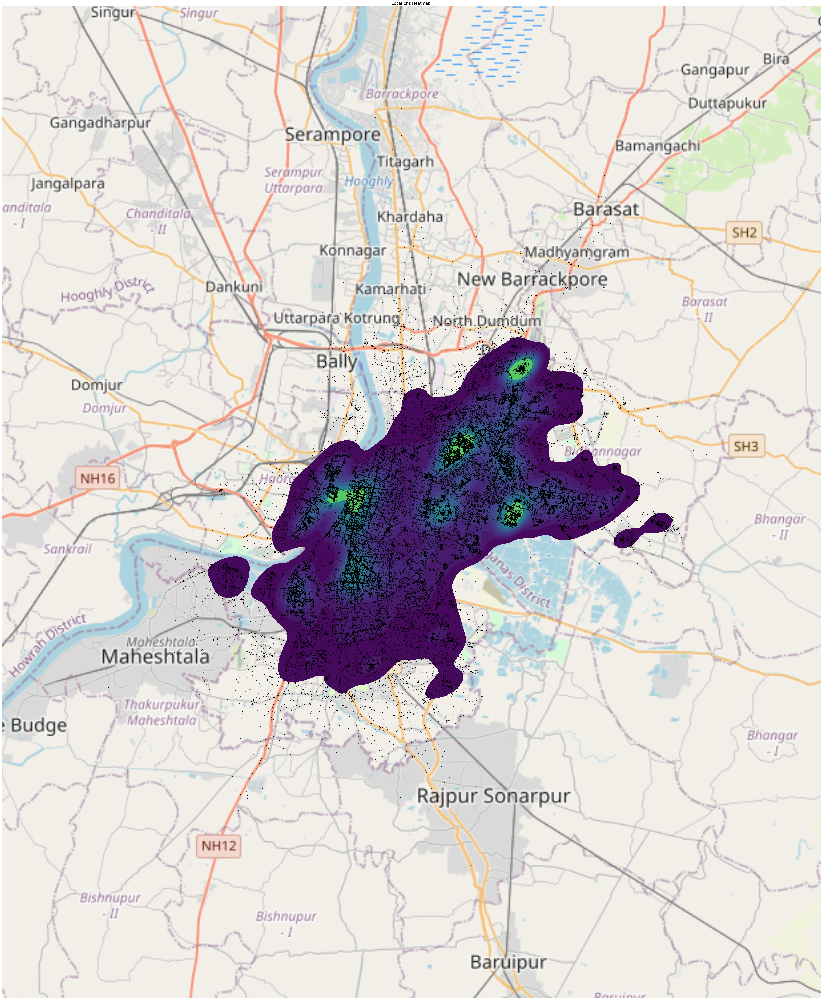

In [13]:
dataset[['latitude', 'longitude']] = dataset['pickup_lat_long'].str.split(',', expand=True)
dataset['latitude'] = dataset['latitude'].astype(float)
dataset['longitude'] = dataset['longitude'].astype(float)

gdataset_coordinates = gpd.GeoDataFrame(dataset, geometry=gpd.points_from_xy(dataset.longitude, dataset.latitude))

gdf = gpd.GeoDataFrame(gdataset_coordinates, geometry=gpd.points_from_xy(gdataset_coordinates.longitude, gdataset_coordinates.latitude))

ax = gplt.kdeplot(
    gdf, cmap='viridis', projection=gcrs.WebMercator(), figsize=(80, 80),
    shade=True
)

gplt.pointplot(gdf, s=1, color='black', ax=ax)

gplt.webmap(gdf, ax=ax)

plt.title('Locations Heatmap', fontsize=18)
plt.show()



22.583474, 88.342969 howrah
22.642434, 88.439351 airport

In [14]:
from haversine import haversine, Unit

dakshindari= (22.604061, 88.403715)
sector_5=(22.576222, 88.435053)
rabindrasadan_metro=(22.541297, 88.347389)
howrah=(22.583474, 88.342969)
airport=(22.642434, 88.439351)

def calculate_distance(coords,lat, lon):
    point_coords = (lat, lon)
    return haversine(coords, point_coords, unit=Unit.KILOMETERS)

dataset['aerial_dist_dakshindari'] = dataset.apply(
    lambda row: calculate_distance(dakshindari,row['latitude'], row['longitude']), axis=1
)
dataset['aerial_dist_sector_V'] = dataset.apply(
    lambda row: calculate_distance(sector_5,row['latitude'], row['longitude']), axis=1
)
dataset['aerial_dist_rabindrasadan_metro'] = dataset.apply(
    lambda row: calculate_distance(rabindrasadan_metro,row['latitude'], row['longitude']), axis=1
)
dataset['aerial_dist_howrah'] = dataset.apply(
    lambda row: calculate_distance(howrah,row['latitude'], row['longitude']), axis=1
)
dataset['aerial_dist_airport'] = dataset.apply(
    lambda row: calculate_distance(airport,row['latitude'], row['longitude']), axis=1
)

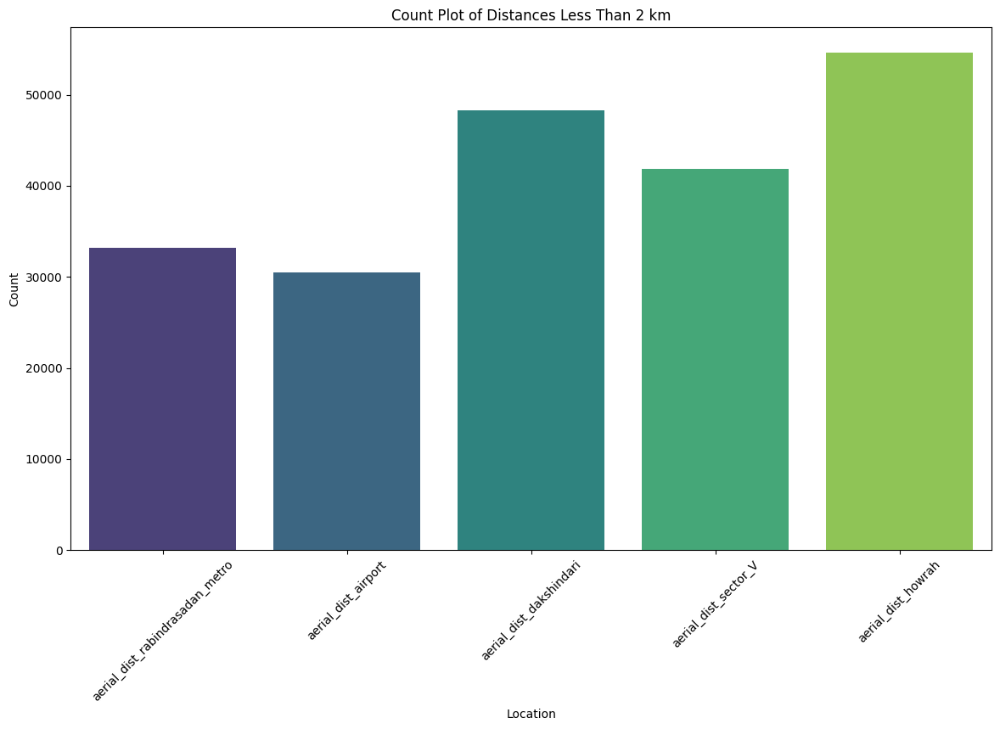

In [15]:
filtered_data = dataset[
    (dataset['aerial_dist_rabindrasadan_metro'] < 2) |
    (dataset['aerial_dist_airport'] < 2) |
    (dataset['aerial_dist_dakshindari'] < 2) |
    (dataset['aerial_dist_sector_V'] < 2) |
    (dataset['aerial_dist_howrah'] < 2)

]

# Melt the DataFrame to long format
melted_data = filtered_data.melt(
    value_vars=[
        'aerial_dist_rabindrasadan_metro',
        'aerial_dist_airport',
        'aerial_dist_dakshindari',
        'aerial_dist_sector_V',
        'aerial_dist_howrah'
    ],
    var_name='location',
    value_name='distance'
)

# Filter the melted data where distance is less than 2
melted_data = melted_data[melted_data['distance'] < 2]

# Plot count plots
plt.figure(figsize=(14, 8))
sns.countplot(data=melted_data, x='location', palette='viridis')
plt.title('Count Plot of Distances Less Than 2 km')
plt.xlabel('Location')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()


In [16]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 415743 entries, 222501 to 95752
Data columns (total 12 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   user_id                          415743 non-null  int64         
 1   pickup_lat_long                  415743 non-null  object        
 2   request_made_at                  415743 non-null  object        
 3   date_column                      415743 non-null  datetime64[ns]
 4   10min_window                     415743 non-null  datetime64[ns]
 5   latitude                         415743 non-null  float64       
 6   longitude                        415743 non-null  float64       
 7   aerial_dist_dakshindari          415743 non-null  float64       
 8   aerial_dist_sector_V             415743 non-null  float64       
 9   aerial_dist_rabindrasadan_metro  415743 non-null  float64       
 10  aerial_dist_howrah               415743 non-n

In [17]:
dataset_rabindrasadan=dataset[dataset['aerial_dist_rabindrasadan_metro']<2]
dataset_airport=dataset[dataset['aerial_dist_airport']<2]
dataset_dakshindari=dataset[dataset['aerial_dist_dakshindari']<2]
dataset_howrah=dataset[dataset['aerial_dist_howrah']<2]
dataset_sectorV=dataset[dataset['aerial_dist_sector_V']<2]

In [18]:
from datetime import datetime, timedelta
import pandas as pd
from prophet import Prophet

dataset_airport['date'] = dataset_airport['date_column'].dt.date
dataset_airport['hour'] = dataset_airport['date_column'].dt.hour

hourly_demand = dataset_airport.groupby(['date', 'hour']).size().reset_index(name='y')

hourly_demand['ds'] = hourly_demand.apply(lambda row: datetime.combine(row['date'], datetime.min.time()) + timedelta(hours=row['hour']), axis=1)

hourly_demand = hourly_demand.drop(columns=['date', 'hour'])

hourly_demand['ds'] = pd.to_datetime(hourly_demand['ds'])

print("Hourly Demand Data:")
print(hourly_demand.head())
print(hourly_demand.info())

Hourly Demand Data:
    y                  ds
0  12 2024-04-01 00:00:00
1   3 2024-04-01 01:00:00
2   1 2024-04-01 02:00:00
3   1 2024-04-01 04:00:00
4   2 2024-04-01 05:00:00
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1155 entries, 0 to 1154
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   y       1155 non-null   int64         
 1   ds      1155 non-null   datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 18.2 KB
None


/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/2624363683.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset_airport['date'] = dataset_airport['date_column'].dt.date
/var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/2624363683.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pan

In [19]:
train_start_date = datetime(2024, 5, 18)  # Adjust the date as needed based on your data

test = hourly_demand[hourly_demand['ds'] > train_start_date]
train = hourly_demand[hourly_demand['ds'] <= train_start_date]

# Print the train and test data to inspect
print("Train Data:")
print(train.head())
print(train.info())

print("Test Data:")
print(test.head())
print(test.info())

Train Data:
    y                  ds
0  12 2024-04-01 00:00:00
1   3 2024-04-01 01:00:00
2   1 2024-04-01 02:00:00
3   1 2024-04-01 04:00:00
4   2 2024-04-01 05:00:00
<class 'pandas.core.frame.DataFrame'>
Index: 1084 entries, 0 to 1083
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   y       1084 non-null   int64         
 1   ds      1084 non-null   datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 25.4 KB
None
Test Data:
      y                  ds
1084  6 2024-05-18 01:00:00
1085  6 2024-05-18 02:00:00
1086  5 2024-05-18 03:00:00
1087  8 2024-05-18 04:00:00
1088  2 2024-05-18 05:00:00
<class 'pandas.core.frame.DataFrame'>
Index: 71 entries, 1084 to 1154
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   y       71 non-null     int64         
 1   ds      71 non-null     datetime64[ns]
dtypes: datetime64[ns](1), int64(1)

In [20]:
model = Prophet()
model.fit(train)

12:30:14 - cmdstanpy - INFO - Chain [1] start processing
12:30:15 - cmdstanpy - INFO - Chain [1] done processing


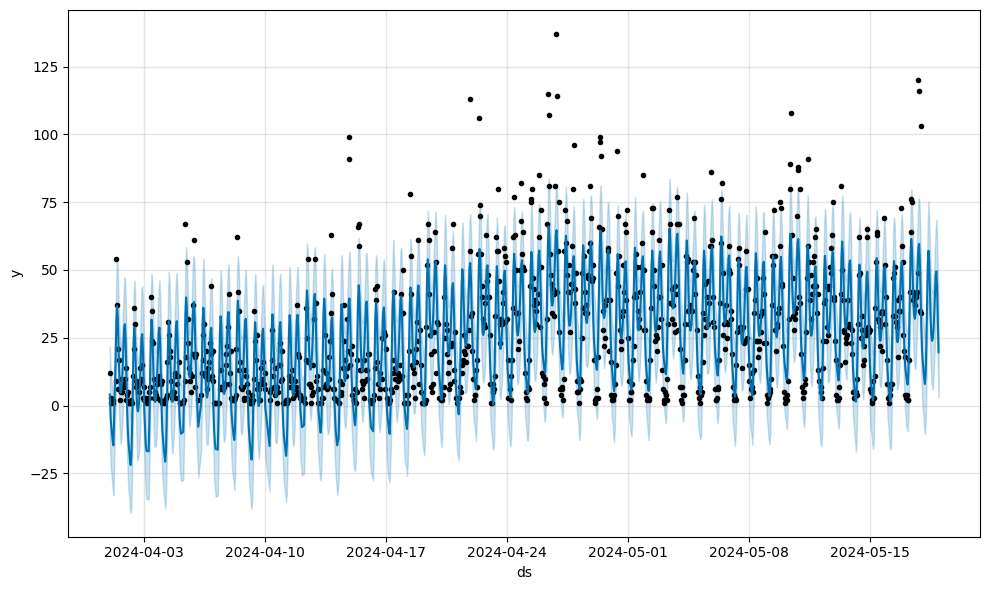

In [21]:
future = model.make_future_dataframe(periods=24, freq='H')
forecast = model.predict(future)
fig1 = model.plot(forecast)


1. Airport

WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/4235552454.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/4235552454.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


12:33:24 - cmdstanpy - INFO - Chain [1] start processing
12:33:25 - cmdstanpy - INFO - Chain [1] done processing


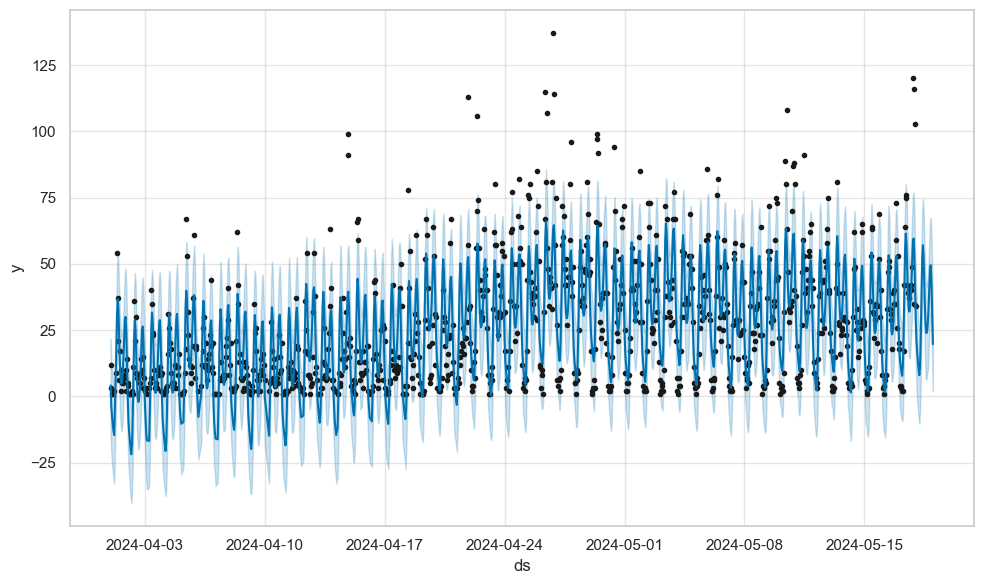

In [76]:
dataset_airport['date'] = dataset_airport['date_column'].dt.date
dataset_airport['hour'] = dataset_airport['date_column'].dt.hour
hourly_demand = dataset_airport.groupby(['date', 'hour']).size().reset_index(name='y')
hourly_demand['ds'] = hourly_demand.apply(lambda row: datetime.combine(row['date'], datetime.min.time()) + timedelta(hours=row['hour']), axis=1)
hourly_demand = hourly_demand.drop(columns=['date', 'hour'])
hourly_demand['ds'] = pd.to_datetime(hourly_demand['ds'])

train_start_date = datetime(2024, 5, 18)  # Adjust the date as needed based on your data

test = hourly_demand[hourly_demand['ds'] > train_start_date]
train = hourly_demand[hourly_demand['ds'] <= train_start_date]

model = Prophet()
model.fit(train)

future = model.make_future_dataframe(periods=24, freq='H')
forecast = model.predict(future)
fig1 = model.plot(forecast)


In [77]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1084,2024-05-18 01:00:00,21.019723
1085,2024-05-18 02:00:00,16.502467
1086,2024-05-18 03:00:00,13.448299
1087,2024-05-18 04:00:00,10.059246
1088,2024-05-18 05:00:00,7.995026
1089,2024-05-18 06:00:00,11.274495
1090,2024-05-18 07:00:00,22.160104
1091,2024-05-18 08:00:00,37.908676
1092,2024-05-18 09:00:00,51.678058
1093,2024-05-18 10:00:00,57.107431


forecast

In [78]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1084,2024-05-18 01:00:00,21.019723
1085,2024-05-18 02:00:00,16.502467
1086,2024-05-18 03:00:00,13.448299
1087,2024-05-18 04:00:00,10.059246
1088,2024-05-18 05:00:00,7.995026
1089,2024-05-18 06:00:00,11.274495
1090,2024-05-18 07:00:00,22.160104
1091,2024-05-18 08:00:00,37.908676
1092,2024-05-18 09:00:00,51.678058
1093,2024-05-18 10:00:00,57.107431


In [24]:
forecast['yhat'].tail(24).sum()

746.9790025309396

/var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/1834822770.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['hour_of_day'] = filtered_data['date_column'].dt.hour


<Figure size 1200x600 with 0 Axes>

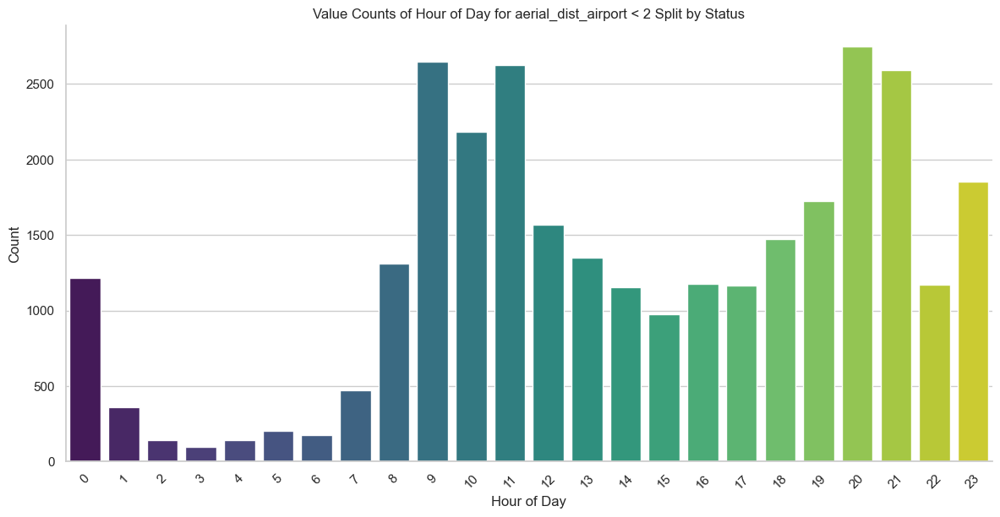

In [25]:
filtered_data = dataset[dataset['aerial_dist_airport'] < 2]
filtered_data['hour_of_day'] = filtered_data['date_column'].dt.hour

# Group by hour_of_day and status, then count the occurrences
hour_status_counts = filtered_data.groupby(['hour_of_day']).size().reset_index(name='count')

# Plot the data
plt.figure(figsize=(12, 6))
sns.set(style="whitegrid")

# Use seaborn's catplot for better handling of multiple categories
g = sns.catplot(
    data=hour_status_counts, kind="bar",
    x="hour_of_day", y="count",
    height=6, aspect=2, palette="viridis"
)

# Customize the plot
plt.title('Value Counts of Hour of Day for aerial_dist_airport < 2 Split by Status')
plt.xlabel('Hour of Day')
plt.ylabel('Count')
plt.xticks(rotation=45)

# Show plot
plt.show()

2. Dakshindari


WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/3554136785.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/3554136785.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


12:33:45 - cmdstanpy - INFO - Chain [1] start processing
12:33:45 - cmdstanpy - INFO - Chain [1] done processing


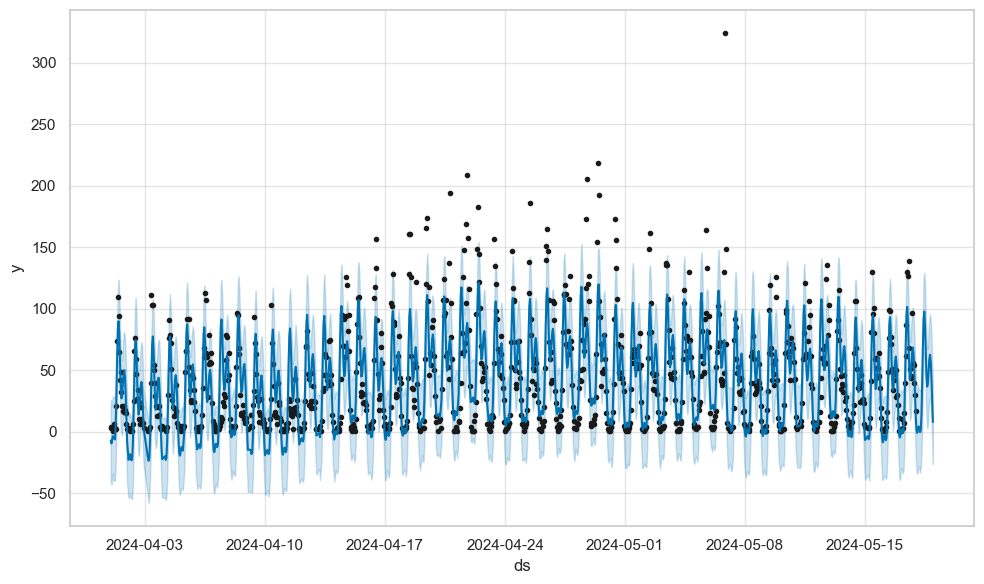

In [79]:
dataset_dakshindari['date'] = dataset_dakshindari['date_column'].dt.date
dataset_dakshindari['hour'] = dataset_dakshindari['date_column'].dt.hour
hourly_demand = dataset_dakshindari.groupby(['date', 'hour']).size().reset_index(name='y')
hourly_demand['ds'] = hourly_demand.apply(lambda row: datetime.combine(row['date'], datetime.min.time()) + timedelta(hours=row['hour']), axis=1)
hourly_demand = hourly_demand.drop(columns=['date', 'hour'])
hourly_demand['ds'] = pd.to_datetime(hourly_demand['ds'])

train_start_date = datetime(2024, 5, 18)  # Adjust the date as needed based on your data

test = hourly_demand[hourly_demand['ds'] > train_start_date]
train = hourly_demand[hourly_demand['ds'] <= train_start_date]

model = Prophet()
model.fit(train)

future = model.make_future_dataframe(periods=24, freq='H')
forecast = model.predict(future)
fig1 = model.plot(forecast)


In [80]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1056,2024-05-18 00:00:00,1.729910
1057,2024-05-18 01:00:00,-0.984815
1058,2024-05-18 02:00:00,1.720886
1059,2024-05-18 03:00:00,4.330737
1060,2024-05-18 04:00:00,3.093217
1061,2024-05-18 05:00:00,-0.258460
1062,2024-05-18 06:00:00,1.074938
1063,2024-05-18 07:00:00,13.958104
1064,2024-05-18 08:00:00,39.205650
1065,2024-05-18 09:00:00,69.248930


3. Howrah

WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/4043479343.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/4043479343.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




12:33:51 - cmdstanpy - INFO - Chain [1] start processing
12:33:51 - cmdstanpy - INFO - Chain [1] done processing


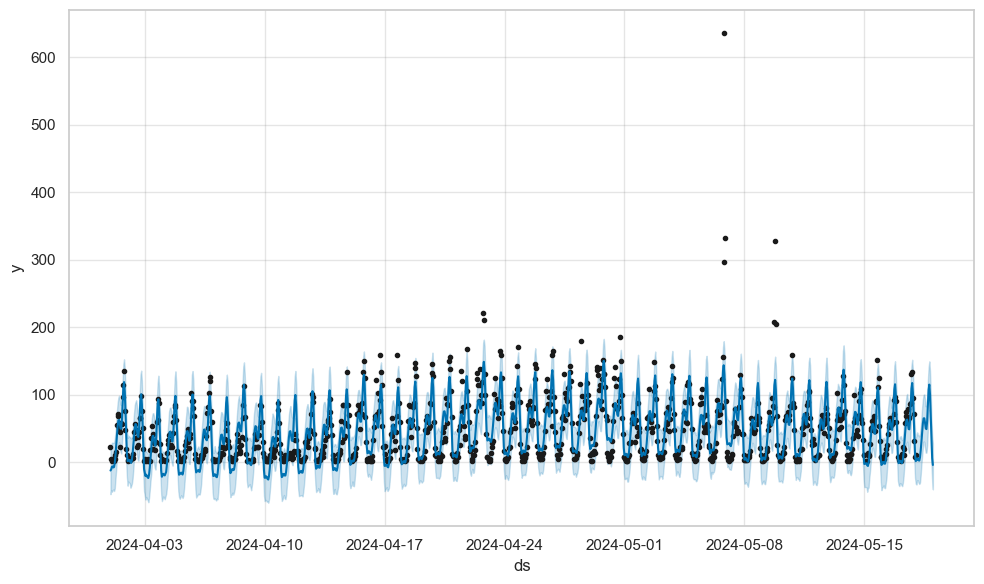

In [81]:
dataset_howrah['date'] = dataset_howrah['date_column'].dt.date
dataset_howrah['hour'] = dataset_howrah['date_column'].dt.hour
hourly_demand = dataset_howrah.groupby(['date', 'hour']).size().reset_index(name='y')
hourly_demand['ds'] = hourly_demand.apply(lambda row: datetime.combine(row['date'], datetime.min.time()) + timedelta(hours=row['hour']), axis=1)
hourly_demand = hourly_demand.drop(columns=['date', 'hour'])
hourly_demand['ds'] = pd.to_datetime(hourly_demand['ds'])

train_start_date = datetime(2024, 5, 18)  # Adjust the date as needed based on your data

test = hourly_demand[hourly_demand['ds'] > train_start_date]
train = hourly_demand[hourly_demand['ds'] <= train_start_date]

model = Prophet()
model.fit(train)

future = model.make_future_dataframe(periods=24, freq='H')
forecast = model.predict(future)
fig1 = model.plot(forecast)


In [82]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1097,2024-05-18 01:00:00,2.481643
1098,2024-05-18 02:00:00,5.411921
1099,2024-05-18 03:00:00,5.136443
1100,2024-05-18 04:00:00,2.604788
1101,2024-05-18 05:00:00,2.222379
1102,2024-05-18 06:00:00,7.288607
1103,2024-05-18 07:00:00,17.770935
1104,2024-05-18 08:00:00,31.346395
1105,2024-05-18 09:00:00,45.369407
1106,2024-05-18 10:00:00,57.419996


4. rabindrasadan

WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/2039790789.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/2039790789.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


12:33:58 - cmdstanpy - INFO - Chain [1] start processing
12:33:58 - cmdstanpy - INFO - Chain [1] done processing


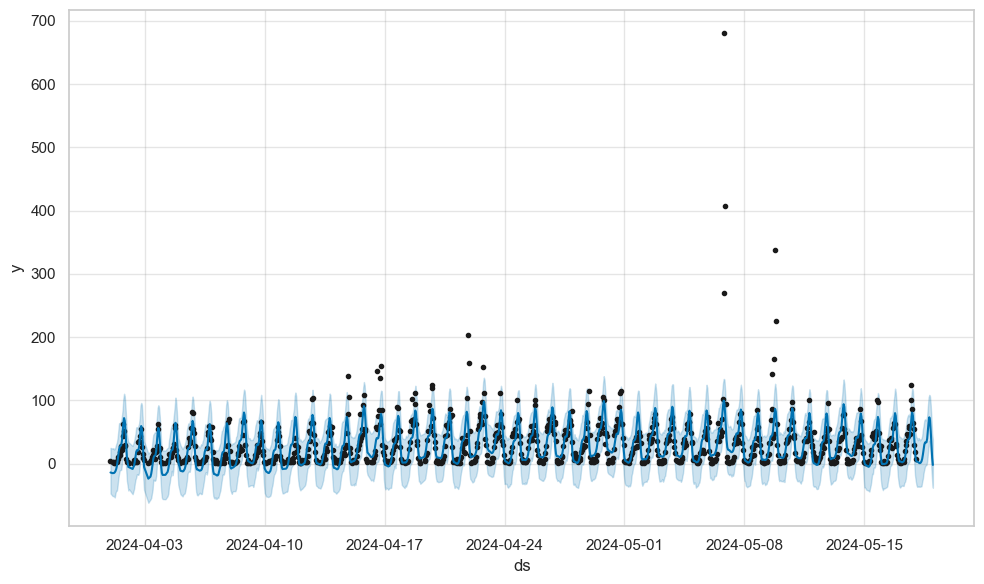

In [83]:
dataset_rabindrasadan['date'] = dataset_rabindrasadan['date_column'].dt.date
dataset_rabindrasadan['hour'] = dataset_rabindrasadan['date_column'].dt.hour
hourly_demand = dataset_rabindrasadan.groupby(['date', 'hour']).size().reset_index(name='y')
hourly_demand['ds'] = hourly_demand.apply(lambda row: datetime.combine(row['date'], datetime.min.time()) + timedelta(hours=row['hour']), axis=1)
hourly_demand = hourly_demand.drop(columns=['date', 'hour'])
hourly_demand['ds'] = pd.to_datetime(hourly_demand['ds'])

train_start_date = datetime(2024, 5, 18)  # Adjust the date as needed based on your data

test = hourly_demand[hourly_demand['ds'] > train_start_date]
train = hourly_demand[hourly_demand['ds'] <= train_start_date]

model = Prophet()
model.fit(train)

future = model.make_future_dataframe(periods=24, freq='H')
forecast = model.predict(future)
fig1 = model.plot(forecast)


In [84]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1020,2024-05-18 01:00:00,3.312129
1021,2024-05-18 02:00:00,3.007754
1022,2024-05-18 03:00:00,2.827006
1023,2024-05-18 04:00:00,1.844398
1024,2024-05-18 05:00:00,0.879752
1025,2024-05-18 06:00:00,0.742881
1026,2024-05-18 07:00:00,1.560900
1027,2024-05-18 08:00:00,3.509754
1028,2024-05-18 09:00:00,7.437637
1029,2024-05-18 10:00:00,14.078561


Sector 5

WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/1838629958.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


WARNING - (py.warnings._showwarnmsg) - /var/folders/q_/dn720rf91691y39h0s_hr_280000gn/T/ipykernel_9877/1838629958.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




12:34:05 - cmdstanpy - INFO - Chain [1] start processing
12:34:05 - cmdstanpy - INFO - Chain [1] done processing


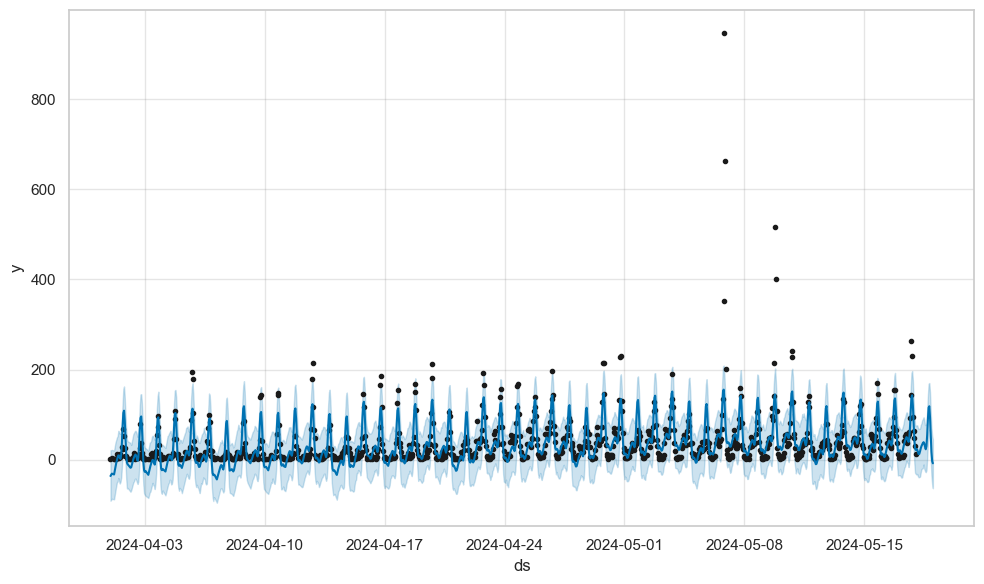

In [85]:
dataset_sectorV['date'] = dataset_sectorV['date_column'].dt.date
dataset_sectorV['hour'] = dataset_sectorV['date_column'].dt.hour
hourly_demand = dataset_sectorV.groupby(['date', 'hour']).size().reset_index(name='y')
hourly_demand['ds'] = hourly_demand.apply(lambda row: datetime.combine(row['date'], datetime.min.time()) + timedelta(hours=row['hour']), axis=1)
hourly_demand = hourly_demand.drop(columns=['date', 'hour'])
hourly_demand['ds'] = pd.to_datetime(hourly_demand['ds'])

train_start_date = datetime(2024, 5, 18)  # Adjust the date as needed based on your data

test = hourly_demand[hourly_demand['ds'] > train_start_date]
train = hourly_demand[hourly_demand['ds'] <= train_start_date]

model = Prophet()
model.fit(train)

future = model.make_future_dataframe(periods=24, freq='H')
forecast = model.predict(future)
fig1 = model.plot(forecast)


In [86]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1058,2024-05-18 01:00:00,23.597614
1059,2024-05-18 02:00:00,22.485176
1060,2024-05-18 03:00:00,17.125892
1061,2024-05-18 04:00:00,12.432808
1062,2024-05-18 05:00:00,12.968000
1063,2024-05-18 06:00:00,18.444587
1064,2024-05-18 07:00:00,25.074847
1065,2024-05-18 08:00:00,30.057565
1066,2024-05-18 09:00:00,33.690622
1067,2024-05-18 10:00:00,37.069633


Kolkata city

12:34:13 - cmdstanpy - INFO - Chain [1] start processing
12:34:13 - cmdstanpy - INFO - Chain [1] done processing


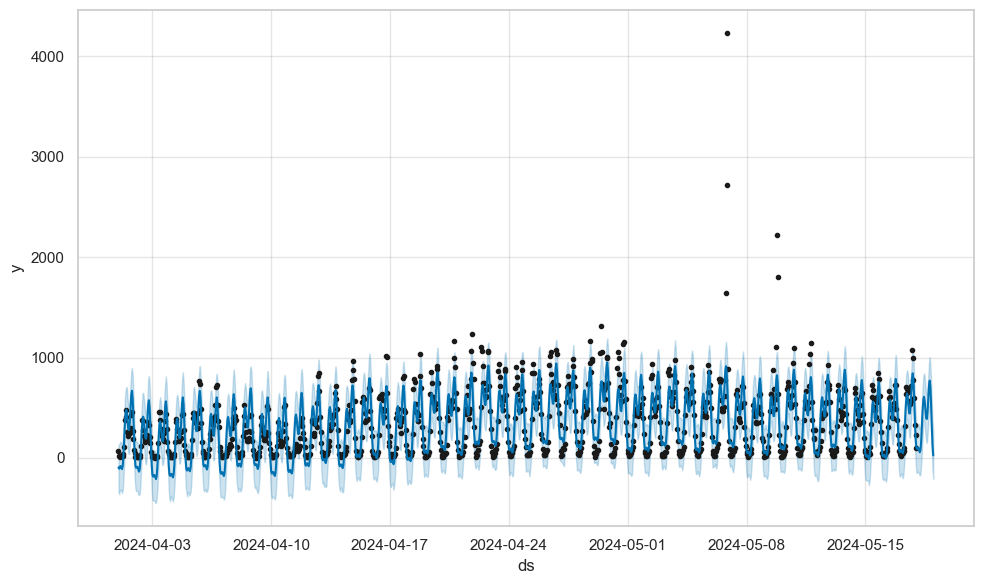

In [87]:
dataset['date'] = dataset['date_column'].dt.date
dataset['hour'] = dataset['date_column'].dt.hour
hourly_demand = dataset.groupby(['date', 'hour']).size().reset_index(name='y')
hourly_demand['ds'] = hourly_demand.apply(lambda row: datetime.combine(row['date'], datetime.min.time()) + timedelta(hours=row['hour']), axis=1)
hourly_demand = hourly_demand.drop(columns=['date', 'hour'])
hourly_demand['ds'] = pd.to_datetime(hourly_demand['ds'])
hourly_demand_copy=hourly_demand

train_start_date = datetime(2024, 5, 18)  # Adjust the date as needed based on your data

test = hourly_demand[hourly_demand['ds'] > train_start_date]
train = hourly_demand[hourly_demand['ds'] <= train_start_date]

model = Prophet()
model.fit(train)

future = model.make_future_dataframe(periods=24, freq='H')
forecast = model.predict(future)
fig1 = model.plot(forecast)


In [88]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1129,2024-05-18 01:00:00,87.462131
1130,2024-05-18 02:00:00,100.073769
1131,2024-05-18 03:00:00,99.964628
1132,2024-05-18 04:00:00,76.041018
1133,2024-05-18 05:00:00,55.703247
1134,2024-05-18 06:00:00,80.903346
1135,2024-05-18 07:00:00,174.645614
1136,2024-05-18 08:00:00,321.833375
1137,2024-05-18 09:00:00,475.590459
1138,2024-05-18 10:00:00,582.305672


In [90]:
forecast[['yhat']].tail(24).sum()

yhat    8685.909851
dtype: float64

In [31]:
hourly_demand_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   y       1200 non-null   int64         
 1   ds      1200 non-null   datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 18.9 KB


In [32]:
hourly_demand['y']

0        64
1        17
2         9
3        21
4        23
       ... 
1195    552
1196    370
1197    300
1198    135
1199     79
Name: y, Length: 1200, dtype: int64

In [33]:
forecast[['ds','yhat']].tail(24)

,ds,yhat
1129,2024-05-18 01:00:00,87.462131
1130,2024-05-18 02:00:00,100.073769
1131,2024-05-18 03:00:00,99.964628
1132,2024-05-18 04:00:00,76.041018
1133,2024-05-18 05:00:00,55.703247
1134,2024-05-18 06:00:00,80.903346
1135,2024-05-18 07:00:00,174.645614
1136,2024-05-18 08:00:00,321.833375
1137,2024-05-18 09:00:00,475.590459
1138,2024-05-18 10:00:00,582.305672


12/4 to 26/4

In [34]:
forecast['yhat'].loc[1374:1391]

Series([], Name: yhat, dtype: float64)

In [35]:
filtered_forecast=forecast.loc[264:599]

In [36]:
filtered_hourly_deman=hourly_demand.loc[264:599]

In [37]:
def compute_metrics(y_true, yhat):
    mae = np.mean(np.abs(y_true - yhat))
    mse = np.mean((y_true - yhat) ** 2)
    mape = np.mean(np.abs((y_true - yhat) / y_true)) * 100
    return mae, mse, mape

mae, mse, mape = compute_metrics(filtered_hourly_deman['y'], filtered_forecast['yhat'])


print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}")

Mean Absolute Error (MAE): 100.88
Mean Squared Error (MSE): 18098.54
Mean Absolute Percentage Error (MAPE): 105.56


In [38]:
future = model.make_future_dataframe(periods=24, freq='H')
future.tail()

,ds
1148,2024-05-18 20:00:00
1149,2024-05-18 21:00:00
1150,2024-05-18 22:00:00
1151,2024-05-18 23:00:00
1152,2024-05-19 00:00:00


In [39]:
forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2024-04-01 00:00:00,169.598970,-345.545158,140.604470,169.598970,169.598970,-265.078883,-265.078883,-265.078883,-297.666750,-297.666750,-297.666750,32.587867,32.587867,32.587867,0.0,0.0,0.0,-95.479912
1,2024-04-01 01:00:00,169.742734,-341.683372,137.847158,169.742734,169.742734,-277.612837,-277.612837,-277.612837,-314.828184,-314.828184,-314.828184,37.215347,37.215347,37.215347,0.0,0.0,0.0,-107.870103
2,2024-04-01 02:00:00,169.886498,-317.761798,142.606553,169.886498,169.886498,-258.289969,-258.289969,-258.289969,-299.950590,-299.950590,-299.950590,41.660622,41.660622,41.660622,0.0,0.0,0.0,-88.403471
3,2024-04-01 03:00:00,170.030262,-321.375741,142.960526,170.030262,170.030262,-251.593752,-251.593752,-251.593752,-297.478101,-297.478101,-297.478101,45.884350,45.884350,45.884350,0.0,0.0,0.0,-81.563490
4,2024-04-01 04:00:00,170.174026,-339.632990,127.394573,170.174026,170.174026,-268.672837,-268.672837,-268.672837,-318.522155,-318.522155,-318.522155,49.849318,49.849318,49.849318,0.0,0.0,0.0,-98.498812
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1148,2024-05-18 20:00:00,356.012153,475.249745,936.263404,355.760365,356.306890,339.533447,339.533447,339.533447,363.142884,363.142884,363.142884,-23.609437,-23.609437,-23.609437,0.0,0.0,0.0,695.545600
1149,2024-05-18 21:00:00,355.798385,287.220817,762.513569,355.515953,356.144510,161.646558,161.646558,161.646558,188.076203,188.076203,188.076203,-26.429645,-26.429645,-26.429645,0.0,0.0,0.0,517.444944
1150,2024-05-18 22:00:00,355.584618,68.066427,539.970477,355.257583,355.967164,-55.574174,-55.574174,-55.574174,-26.639894,-26.639894,-26.639894,-28.934280,-28.934280,-28.934280,0.0,0.0,0.0,300.010445
1151,2024-05-18 23:00:00,355.370851,-120.190126,370.312937,355.012319,355.816171,-234.930869,-234.930869,-234.930869,-203.835602,-203.835602,-203.835602,-31.095267,-31.095267,-31.095267,0.0,0.0,0.0,120.439982


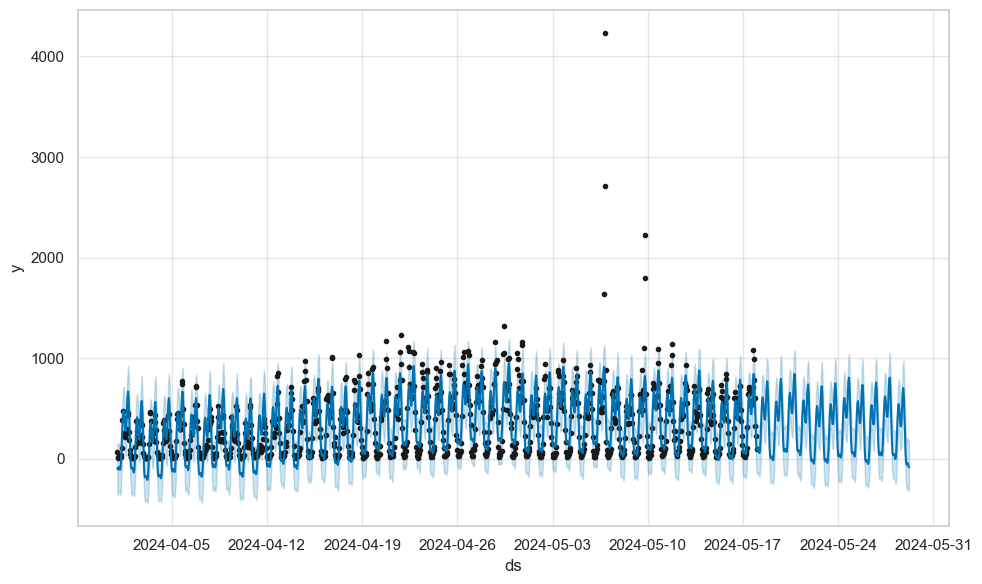

In [40]:
start_date = pd.to_datetime('2024-05-18 20:00:00')  # Start from the last date in your original data
end_date = pd.to_datetime('2024-05-30 00:00:00')  # Desired end date for prediction

future = model.make_future_dataframe(periods=(end_date - start_date).days * 24 + (end_date - start_date).seconds // 3600 + 1, freq='H', include_history=True)

# Make predictions for the specified date range
forecast = model.predict(future)
fig1 = model.plot(forecast)



In [41]:
forecast.tail(50)

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
1348,2024-05-27 04:00:00,313.258705,-211.297160,289.804062,284.767299,344.501536,-268.672837,-268.672837,-268.672837,-318.522155,-318.522155,-318.522155,49.849318,49.849318,49.849318,0.0,0.0,0.0,44.585867
1349,2024-05-27 05:00:00,313.044938,-220.283587,264.163584,284.355656,344.558358,-282.182648,-282.182648,-282.182648,-335.703442,-335.703442,-335.703442,53.520793,53.520793,53.520793,0.0,0.0,0.0,30.862289
1350,2024-05-27 06:00:00,312.831170,-176.725596,293.485512,283.948779,344.670119,-250.227191,-250.227191,-250.227191,-307.094037,-307.094037,-307.094037,56.866846,56.866846,56.866846,0.0,0.0,0.0,62.603979
1351,2024-05-27 07:00:00,312.617403,-71.471487,397.190941,283.437440,344.682553,-149.858018,-149.858018,-149.858018,-209.716660,-209.716660,-209.716660,59.858642,59.858642,59.858642,0.0,0.0,0.0,162.759385
1352,2024-05-27 08:00:00,312.403636,73.036650,556.193491,283.067866,344.736134,3.773005,3.773005,3.773005,-58.697696,-58.697696,-58.697696,62.470701,62.470701,62.470701,0.0,0.0,0.0,316.176641
1353,2024-05-27 09:00:00,312.189869,242.782307,727.715051,282.585617,344.783023,163.735657,163.735657,163.735657,99.054543,99.054543,99.054543,64.681114,64.681114,64.681114,0.0,0.0,0.0,475.925526
1354,2024-05-27 10:00:00,311.976101,331.579365,826.532339,282.212116,344.731332,276.366312,276.366312,276.366312,209.894585,209.894585,209.894585,66.471727,66.471727,66.471727,0.0,0.0,0.0,588.342414
1355,2024-05-27 11:00:00,311.762334,384.982996,859.354776,281.838614,344.674652,308.566457,308.566457,308.566457,240.738177,240.738177,240.738177,67.828280,67.828280,67.828280,0.0,0.0,0.0,620.328791
1356,2024-05-27 12:00:00,311.548567,324.746189,817.280117,281.264813,344.605402,263.321739,263.321739,263.321739,194.581238,194.581238,194.581238,68.740501,68.740501,68.740501,0.0,0.0,0.0,574.870306
1357,2024-05-27 13:00:00,311.334800,252.350095,733.709561,280.690230,344.532631,178.203591,178.203591,178.203591,109.001427,109.001427,109.001427,69.202165,69.202165,69.202165,0.0,0.0,0.0,489.538391


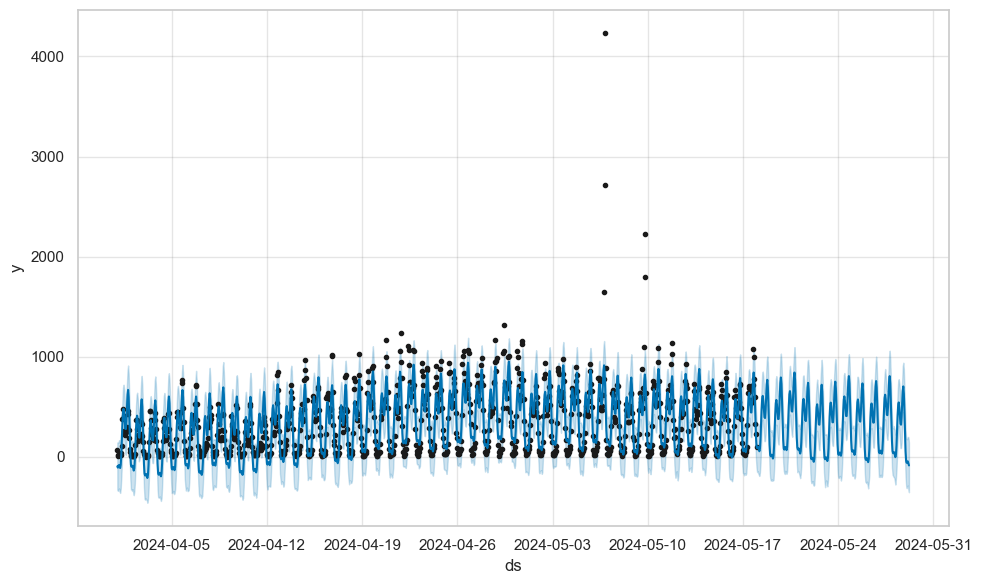

In [43]:
future = model.make_future_dataframe(periods=(end_date - start_date).days * 24 + (end_date - start_date).seconds // 3600 + 1, freq='H', include_history=True)

# Make predictions for the specified date range
forecast = model.predict(future)

# Plot the forecast with actual data points
fig1 = model.plot(forecast)

In [44]:
khiderpore=(22.536275, 88.319104)

def calculate_distance(coords,lat, lon):
    point_coords = (lat, lon)
    return haversine(coords, point_coords, unit=Unit.KILOMETERS)

dataset['aerial_dist_khideropore'] = dataset.apply(
    lambda row: calculate_distance(khiderpore,row['latitude'], row['longitude']), axis=1
)

In [45]:
dataset[dataset['aerial_dist_khideropore']<2]

,user_id,pickup_lat_long,request_made_at,date_column,10min_window,latitude,longitude,aerial_dist_dakshindari,aerial_dist_sector_V,aerial_dist_rabindrasadan_metro,aerial_dist_howrah,aerial_dist_airport,date,hour,aerial_dist_khideropore
42632,13120350,"22.543349,88.329388",2024-05-02 16:42:55,2024-05-02 16:42:55,2024-05-02 16:40:00,22.543349,88.329388,10.188997,11.449524,1.862720,4.674564,15.774423,2024-05-02,16,1.316908
10482,13120447,"22.543121,88.309784",2024-04-26 15:23:59,2024-04-26 15:23:59,2024-04-26 15:20:00,22.543121,88.309784,11.786987,13.379657,3.867336,5.634282,17.288218,2024-04-26,15,1.222978
422234,13120921,"22.5379,88.3342",2024-05-10 18:38:03,2024-05-10 18:38:03,2024-05-10 18:30:00,22.537900,88.334200,10.250290,11.198828,1.406211,5.146982,15.863350,2024-05-10,18,1.560903
402896,13120974,"22.5488,88.3271",2024-05-18 18:54:17,2024-05-18 18:54:17,2024-05-18 18:50:00,22.548800,88.327100,9.981869,11.496812,2.244449,4.185763,15.530512,2024-05-18,18,1.616789
35046,13121398,"22.535951,88.327226",2024-05-04 15:02:56,2024-05-04 15:02:56,2024-05-04 15:00:00,22.535951,88.327226,10.910545,11.943860,2.154417,5.526070,16.513742,2024-05-04,15,0.834940
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97174,15724266,"22.540655,88.318357",2024-05-20 16:06:32,2024-05-20 16:06:32,2024-05-20 16:00:00,22.540655,88.318357,11.248186,12.618967,2.982452,5.390430,16.804086,2024-05-20,16,0.493040
96410,15724818,"22.548987,88.328687",2024-05-20 18:56:00,2024-05-20 18:56:00,2024-05-20 18:50:00,22.548987,88.328687,9.841013,11.334190,2.102393,4.105629,15.395965,2024-05-20,18,1.722382
96486,15724878,"22.543895,88.319892",2024-05-20 18:35:37,2024-05-20 18:35:37,2024-05-20 18:30:00,22.543895,88.319892,10.900999,12.359705,2.838658,4.998384,16.445631,2024-05-20,18,0.851163
96432,15724946,"22.544955,88.322717",2024-05-20 18:51:31,2024-05-20 18:51:31,2024-05-20 18:50:00,22.544955,88.322717,10.599968,12.047868,2.566225,4.761263,16.151138,2024-05-20,18,1.034042


16k requests in 30 days. 


In [46]:
hourly_demand.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   y       1200 non-null   int64         
 1   ds      1200 non-null   datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 18.9 KB


In [47]:
hourly_demand.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   y       1200 non-null   int64         
 1   ds      1200 non-null   datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 18.9 KB


In [48]:
import pandas as pd
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt


hourly_demand = hourly_demand.set_index('ds')



In [49]:
hourly_demand.head()

,y
ds,
2024-04-01 00:00:00,64
2024-04-01 01:00:00,17
2024-04-01 02:00:00,9
2024-04-01 03:00:00,21
2024-04-01 04:00:00,23


In [50]:


model = ARIMA(hourly_demand['y'], order=(0, 1, 1))  # Order: (p, d, q)
model_fit = model.fit()
print(model_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                 1200
Model:                 ARIMA(0, 1, 1)   Log Likelihood               -7809.423
Date:                Wed, 05 Jun 2024   AIC                          15622.846
Time:                        12:30:46   BIC                          15633.025
Sample:                    04-01-2024   HQIC                         15626.681
                         - 05-20-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.4593      0.005     88.470      0.000       0.449       0.470
sigma2       2.66e+04    190.203    139.825      0.000    2.62e+04     2.7e+04
Ljung-Box (L1) (Q):                   0.07   Jarque-

/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


                             y
2024-05-20 23:00:00  86.881118
2024-05-21 00:00:00  86.881118
2024-05-21 01:00:00  86.881118
2024-05-21 02:00:00  86.881118
2024-05-21 03:00:00  86.881118
...                        ...
2024-05-23 18:00:00  86.881118
2024-05-23 19:00:00  86.881118
2024-05-23 20:00:00  86.881118
2024-05-23 21:00:00  86.881118
2024-05-23 22:00:00  86.881118

[72 rows x 1 columns]


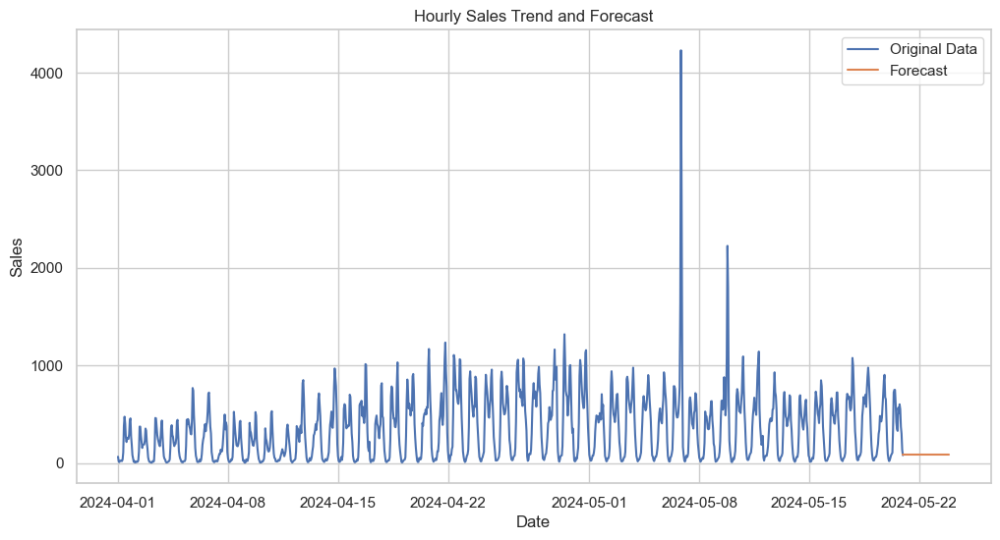

In [51]:
future_dates = pd.date_range(start=hourly_demand.index[-1], periods=72, freq='H')

# Forecast for the next 3 days
forecast = model_fit.forecast(steps=72)[0]

# Create a new DataFrame with the forecast values
forecast_df = pd.DataFrame({'y': forecast}, index=future_dates)
print(forecast_df)

# Plot the original data and forecasts
plt.figure(figsize=(12, 6))
plt.plot(hourly_demand.index, hourly_demand['y'], label='Original Data')
plt.plot(forecast_df.index, forecast_df['y'], label='Forecast')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.title('Hourly Sales Trend and Forecast')
plt.legend()
plt.show()

In [53]:
train_data.info()

NameError: name 'train_data' is not defined

In [54]:
from pmdarima import auto_arima

stepwise_model = auto_arima(hourly_demand['y'], start_p=0, start_q=0, max_p=5, max_q=5, seasonal=False, trace=True)
print(stepwise_model.summary())

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=15845.303, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=15688.781, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=15624.846, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=15843.303, Time=0.02 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=15626.534, Time=0.21 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=15626.354, Time=0.17 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.40 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=15622.846, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=15624.534, Time=0.10 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=15624.354, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=15686.780, Time=0.02 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=inf, Time=0.23 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 1.568 seconds
                               SARIMAX Results                                
Dep. Vari

In [55]:
hourly_demand.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1200 entries, 2024-04-01 00:00:00 to 2024-05-20 23:00:00
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   y       1200 non-null   int64
dtypes: int64(1)
memory usage: 18.8 KB


In [56]:
import os
import warnings
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import datetime as dt
import math

from pandas.plotting import autocorrelation_plot
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.preprocessing import MinMaxScaler



In [57]:
hourly_demand.head()

,y
ds,
2024-04-01 00:00:00,64
2024-04-01 01:00:00,17
2024-04-01 02:00:00,9
2024-04-01 03:00:00,21
2024-04-01 04:00:00,23


In [58]:
hourly_demand.tail()

,y
ds,
2024-05-20 19:00:00,552
2024-05-20 20:00:00,370
2024-05-20 21:00:00,300
2024-05-20 22:00:00,135
2024-05-20 23:00:00,79


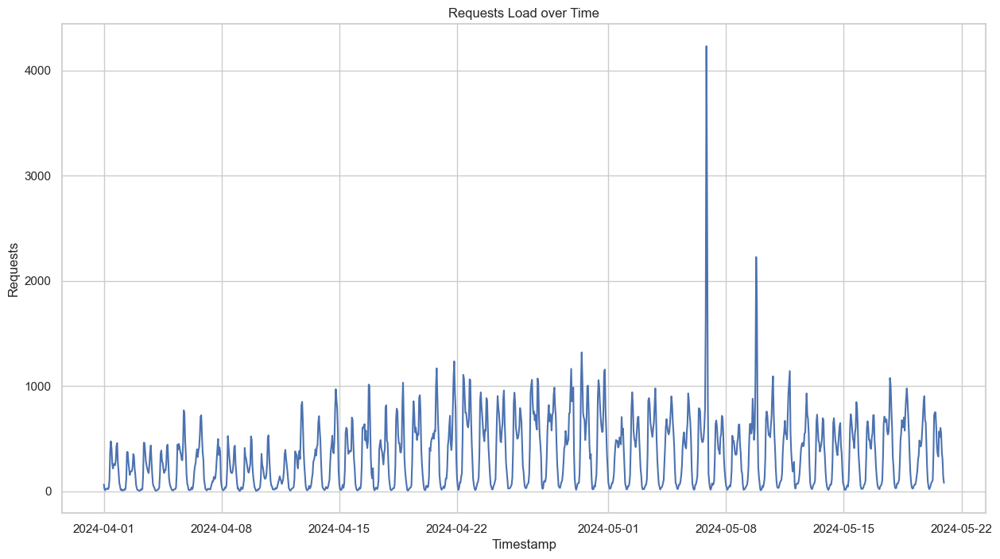

In [59]:


plt.figure(figsize=(15, 8))
plt.plot(hourly_demand.index, hourly_demand['y'])
plt.xlabel('Timestamp')
plt.ylabel('Requests')
plt.title('Requests Load over Time')
plt.show()

In [60]:
train_start_dt = '2024-04-01 00:00:00'
test_start_dt = '2024-05-18 00:00:00'

train = hourly_demand.loc[train_start_dt:test_start_dt].copy()
test = hourly_demand.loc[test_start_dt:].copy()

In [61]:
scaler = MinMaxScaler()
train['load_scaled'] = scaler.fit_transform(train[['y']])
test['load_scaled'] = scaler.transform(test[['y']])

In [62]:
model = SARIMAX(train['load_scaled'], order=(1, 1, 1))
model_fit = model.fit(disp=False)
train['predictions'] = model_fit.predict(start=train_start_dt, end=test_start_dt)
test['predictions'] = model_fit.predict(start=test_start_dt, end=test.index[-1])

/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)
/Users/aayushjain/Library/Python/3.9/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  self._init_dates(dates, freq)


In [63]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

mae = mean_absolute_error(test['load_scaled'], test['predictions'])
mse = mean_squared_error(test['load_scaled'], test['predictions'])
rmse = np.sqrt(mse)

print(f"Mean Absolute Error: {mae:.4f}")
print(f"Mean Squared Error: {mse:.4f}")
print(f"Root Mean Squared Error: {rmse:.4f}")

Mean Absolute Error: 0.0795
Mean Squared Error: 0.0107
Root Mean Squared Error: 0.1033


ValueError: Expected 2D array, got 1D array instead:
array=[0.05433111 0.00667618 0.00729813 0.00727209 0.00727318 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314
 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314 0.00727314].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

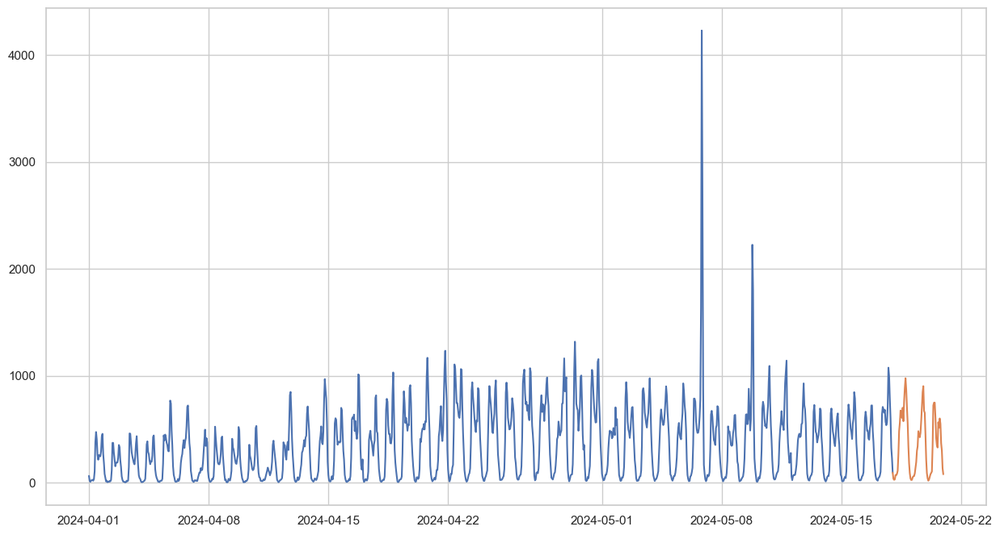

In [64]:
plt.figure(figsize=(15, 8))
plt.plot(train.index, train['y'], label='Training Data')
plt.plot(test.index, test['y'], label='Actual Data')
plt.plot(test.index, scaler.inverse_transform(test['predictions']), label='Predictions')
plt.xlabel('Timestamp')
plt.ylabel('Load')
plt.title('ARIMA Model - Cab Load Forecast')
plt.legend()
plt.show()

In [ ]:
! pip install neuralprophet


Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 145.4/145.4 kB 1.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 10.4 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.0/14.0 MB 19.8 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 829.5/829.5 kB 4.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 868.8/868.8 kB 11.1 MB/s eta 0:00:0000:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.3
    Uninstalling numpy-1.24.3:
      Successfully uninstalled numpy-1.24.3

[notice] A new release of pip is available: 23.1.2 -> 24.0
[notice] To update, run: /Applications/Xcode.app/Contents/Developer/usr/bin/python3 -m pip install --upgrade pip


In [67]:
from neuralprophet import NeuralProphet


Importing plotly failed. Interactive plots will not work.
Importing plotly failed. Interactive plots will not work.


In [91]:
hourly_demand.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   y       1200 non-null   int64         
 1   ds      1200 non-null   datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 18.9 KB


In [68]:
hourly_demand.head()

,y
ds,
2024-04-01 00:00:00,64
2024-04-01 01:00:00,17
2024-04-01 02:00:00,9
2024-04-01 03:00:00,21
2024-04-01 04:00:00,23


In [69]:
m = NeuralProphet()
m.set_plotting_backend("plotly-static")  # show plots correctly in jupyter notebooks
metrics = m.fit(hourly_demand_copy)

WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as H
INFO - (NP.config.init_data_params) - Setting normalization to global as only one dataframe provided for training.
INFO - (NP.utils.set_auto_seasonalities) - Disabling yearly seasonality. Run NeuralProphet with yearly_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO - (NP.config.set_auto_batch_epoch) - Auto-set epochs to 110
WARNING - (py.warnings._showwarnmsg) - /Users/aayushjain/Library/Python/3.9/lib/python/site-packages/pytorch_lightning/trainer/setup.py:201: UserWarning: MPS available but not used. Set `accelerator` and `devices` using `Trainer(accelerator='mps', devices=1)`.
  rank_zero_warn(

WARNING - (NP.config.set_lr_finder_a

Epoch 110: 100%|██████████| 110/110 [00:00<00:00, 1237.85it/s, loss=0.0293, v_num=3, MAE=103.0, RMSE=154.0, Loss=0.0305, RegLoss=0.000]  


INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H


Predicting DataLoader 0: 100%|██████████| 2/2 [00:00<00:00, 407.31it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H



Predicting DataLoader 0: 100%|██████████| 2/2 [00:00<00:00, 505.03it/s]


INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column


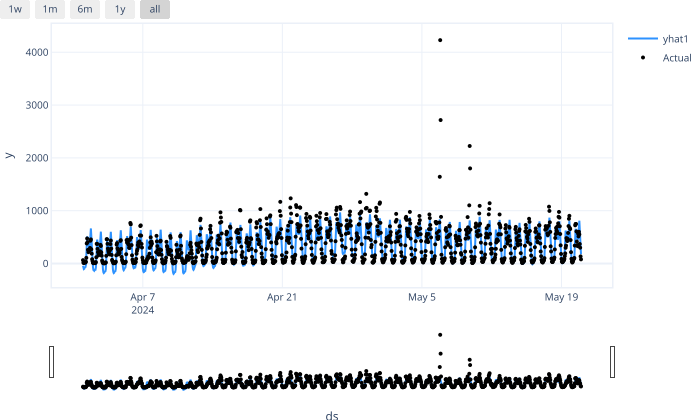

In [70]:
predicted = m.predict(hourly_demand_copy)
forecast = m.predict(hourly_demand_copy)
m.plot(forecast)


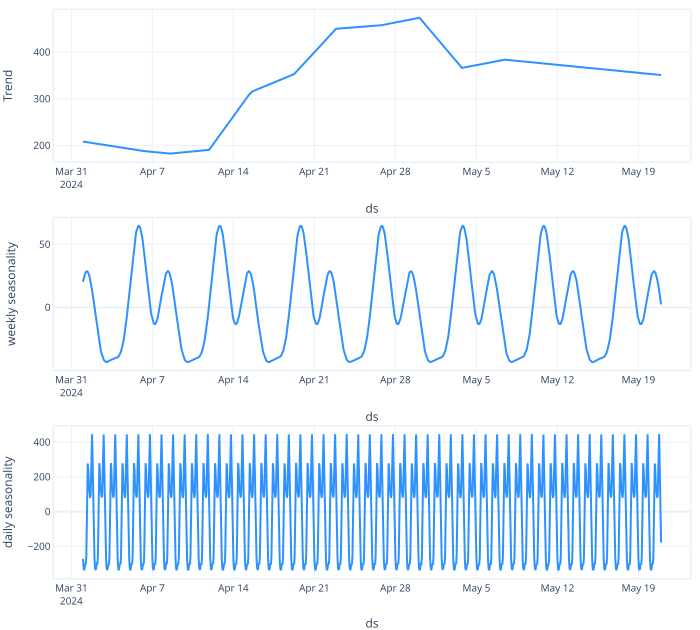

In [71]:
m.plot_components(forecast)


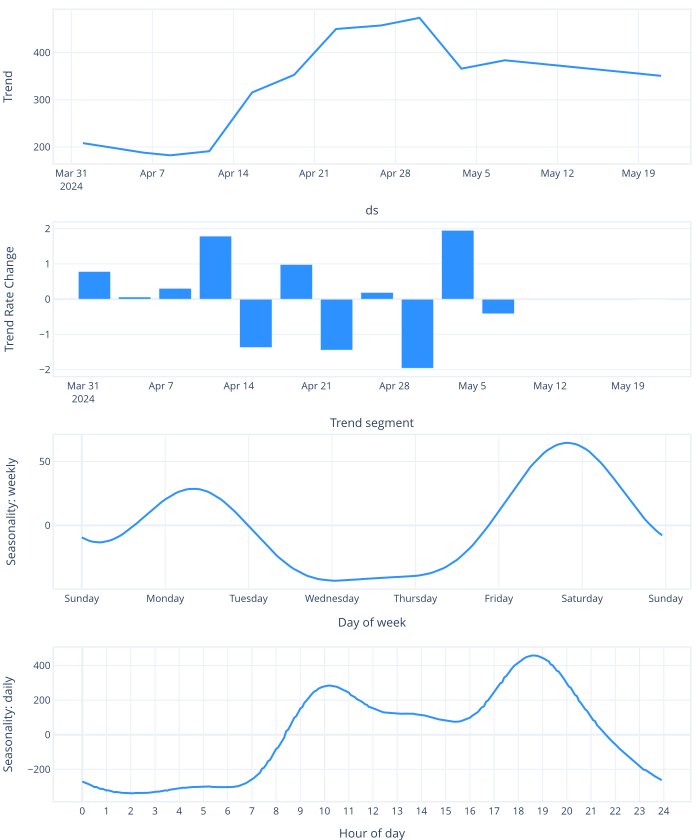

In [72]:
m.plot_parameters()


In [73]:
m = NeuralProphet(n_lags=10, quantiles=[0.05, 0.95])
m.set_plotting_backend("plotly-static")
metrics = m.fit(hourly_demand_copy)
forecast = m.predict(hourly_demand_copy)

WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as H
INFO - (NP.config.init_data_params) - Setting normalization to global as only one dataframe provided for training.
INFO - (NP.utils.set_auto_seasonalities) - Disabling yearly seasonality. Run NeuralProphet with yearly_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO - (NP.config.set_auto_batch_epoch) - Auto-set epochs to 110
WARNING - (py.warnings._showwarnmsg) - /Users/aayushjain/Library/Python/3.9/lib/python/site-packages/pytorch_lightning/trainer/setup.py:201: UserWarning:

MPS available but not used. Set `accelerator` and `devices` using `Trainer(accelerator='mps', devices=1)`.


WARNING - (NP.config.set_lr_finder_args) - Learning 

Epoch 110: 100%|██████████| 110/110 [00:00<00:00, 775.59it/s, loss=0.024, v_num=4, MAE=62.30, RMSE=98.10, Loss=0.021, RegLoss=0.000]     

INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.917% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H



Predicting DataLoader 0: 100%|██████████| 2/2 [00:00<00:00, 71.91it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column


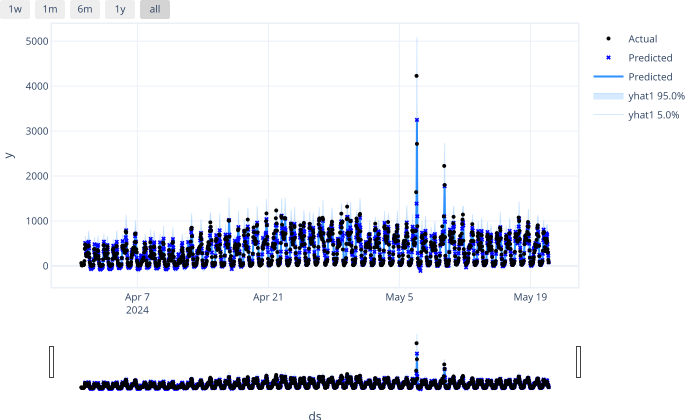

In [74]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast)


In [75]:
from neuralprophet import NeuralProphet, set_log_level

# Disable logging messages unless there is an error
set_log_level("ERROR")

# Model and prediction
m = NeuralProphet(
    n_changepoints=10,
    yearly_seasonality=True,
    weekly_seasonality=True,
    daily_seasonality=False,
    n_lags=10,  # Autogression
)
m.set_plotting_backend("plotly-static")

# Add temperature of last three days as lagged regressor
m.add_lagged_regressor("y", n_lags=3)

# Continue training the model and making a prediction
metrics = m.fit(hourly_demand_copy)
forecast = m.predict(hourly_demand_copy)

ValueError: Name 'y' is reserved.

In [ ]:
fig = dataset.plot(figsize=(15, 5))


Error in callback <function _draw_all_if_interactive at 0x16572ac10> (for post_execute):


ValueError: Date ordinal -786306.5 converts to -183-03-02T12:00:00.000000 (using epoch 1970-01-01T00:00:00), but Matplotlib dates must be between year 0001 and 9999.

ValueError: Date ordinal -786306.5 converts to -183-03-02T12:00:00.000000 (using epoch 1970-01-01T00:00:00), but Matplotlib dates must be between year 0001 and 9999.

<Figure size 1500x500 with 1 Axes>

WARNING - (py.warnings._showwarnmsg) - /Users/aayushjain/Library/Python/3.9/lib/python/site-packages/pytorch_lightning/trainer/setup.py:201: UserWarning:

MPS available but not used. Set `accelerator` and `devices` using `Trainer(accelerator='mps', devices=1)`.


Finding best initial lr: 100%|██████████| 227/227 [00:00<00:00, 314.09it/s]


Predicting DataLoader 0: 100%|██████████| 2/2 [00:00<00:00, 158.94it/s]


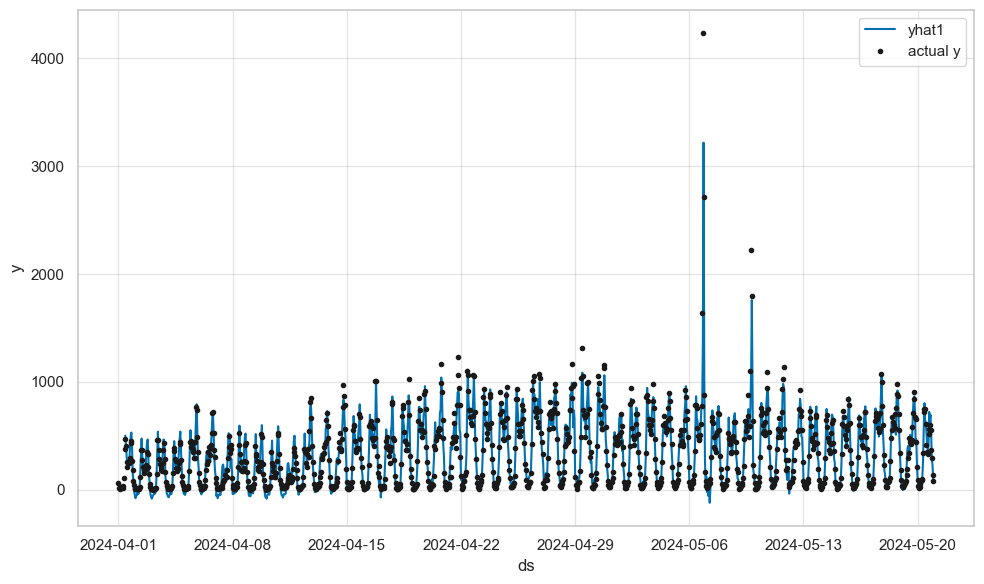

In [ ]:
m = NeuralProphet(
    # Disable trend changepoints
    n_changepoints=10,
    # Disable seasonality components
    weekly_seasonality=True,
    daily_seasonality=True,
    # Add the autogression
    n_lags=10,
)
m.set_plotting_backend("matplotlib")  # Use matplotlib due to #1235
metrics = m.fit(hourly_demand_copy)
forecast = m.predict(hourly_demand_copy)
m.plot(forecast)

In [ ]:
36+48

84

In [ ]:
forecast.loc[336:384].describe()

,ds,y,yhat1,ar1,trend,season_weekly,season_daily
count,49,49.000000,49.000000,49.000000,49.000000,49.000000,49.000000
mean,2024-04-16 00:00:00,322.571429,310.685852,5.922923,309.560760,0.245818,-5.043619
min,2024-04-15 00:00:00,7.000000,-12.525058,-140.886383,287.285217,-35.507610,-341.508331
25%,2024-04-15 12:00:00,61.000000,31.424204,-29.332544,302.843750,-23.893608,-276.008301
50%,2024-04-16 00:00:00,319.000000,377.863342,4.142696,310.787323,4.213322,84.024643
75%,2024-04-16 12:00:00,555.000000,519.252136,23.170389,318.186981,23.719803,153.429840
max,2024-04-17 00:00:00,1013.000000,1018.898987,278.673187,325.586670,28.473074,450.621399
std,NaN,273.111622,268.491180,68.152077,10.705835,23.825697,256.018585
